<a href="https://colab.research.google.com/github/Joseph-A-Mason/Colab_notebooks/blob/main/Lake_Chad_Landsat_gif.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This notebook makes an animated GIF image from an Earth Engine time series image collection. It  is a modified version of a notebook by Justin Braaten (https://github.com/jdbcode); I have modified the long code block that selects data, adds a shaded relief background, calculates dates, etc. A filmstrip is created that is chopped into frames. The frames are annotated with the image date according to text position and style you define. The resulting frames are combined into an animated GIF file using the image magick utility. The final step optionally compresses the GIF.


Set up Earth Engine

In [ ]:
import ee
ee.Authenticate()
ee.Initialize(project='aeol-masonja')

Develop the image collection. Collects less than 20% cloud cover Landsat 5 and 8 from September and October (early dry season) in Lake Chad area.



`

In [2]:
aoi = ee.Geometry.Polygon(
  [[[13.118011561845927, 14.20436755751603],
          [13.118011561845927, 12.354642959139879],
          [15.249359218095927, 12.354642959139879],
          [15.249359218095927, 14.20436755751603]]],
    None, False)

LS8_col = (ee.ImageCollection('LANDSAT/LC08/C02/T1_L2')
  .filterDate(ee.Date('2013-09-01'), ee.Date('2022-10-23'))
  .filter(ee.Filter.calendarRange(9,10,'month'))
  .filter(ee.Filter.lt('CLOUD_COVER',20))
  .filter(ee.Filter.eq('WRS_ROW',51))
  .filter(ee.Filter.eq('WRS_PATH',185))
  .filterBounds(aoi))

visArgsLS8 = {
  'bands': ['SR_B4', 'SR_B3', 'SR_B2'],
  'min': 0.0,
  'max': 0.35
}

def applyScaleFactors(image):
  opticalBands = image.select('SR_B.').multiply(0.0000275).add(-0.2)
  return image.addBands(srcImg = opticalBands, overwrite = True)

LS8_col = LS8_col.map(applyScaleFactors)

def visFunLS8(img):
  return (img.visualize(**visArgsLS8)
  .set('date', img.date()
  .format('YYYY.MM.dd'))
  .copyProperties(img, img.propertyNames()))

LS8_colRGB = LS8_col.map(visFunLS8)

LS5_col = (ee.ImageCollection('LANDSAT/LT05/C02/T1_L2')
    .filterDate(ee.Date('1984-09-01'), ee.Date('2011-10-23'))
    .filter(ee.Filter.calendarRange(9,10,'month'))
    .filter(ee.Filter.eq('WRS_ROW',51))
    .filter(ee.Filter.eq('WRS_PATH',185))
    .filter(ee.Filter.lt('CLOUD_COVER',20))
    .filterBounds(aoi))

LS5_col = LS5_col.map(applyScaleFactors)

visArgsLS5 = {
  'bands': ['SR_B3', 'SR_B2', 'SR_B1'],
  'min': 0.0,
  'max': 0.35,
}

def visFunLS5(img):
  return (img.visualize(**visArgsLS5)
  .set('date', img.date().format('YYYY.MM.dd'))
  .copyProperties(img, img.propertyNames()))

LS5_colRGB = LS5_col.map(visFunLS5)

LS_colRGB = LS5_colRGB.merge(LS8_colRGB)

dates = LS_colRGB.aggregate_array('date').getInfo()

Generate a thumbnail filmstrip URL from the image collection

In [3]:
from googleapiclient.model import absolute_import
filmstrip_params = {
  'dimensions': 720,
  'region': aoi,
  'crs': 'EPSG:4326',
  'framesPerSecond': 0.5
}

filmstrip_url = LS_colRGB.getFilmstripThumbURL(filmstrip_params)

Get some packages and modules for dealing with images

In [4]:
import urllib.request
from PIL import Image, ImageDraw, ImageFont
import glob
from IPython.display import Image as ImageGIF

Fetch the image collection thumbnail filmstrip

In [5]:
filmstrip_name = 'filmstrip.png'
urllib.request.urlretrieve(filmstrip_url, filmstrip_name)

('filmstrip.png', <http.client.HTTPMessage at 0x78843c5c8790>)

Get some info about the filmstrip

In [6]:
filmstrip_im = Image.open(filmstrip_name)
width, height = filmstrip_im.size
crop_interval = height / len(dates)
print(width, height, crop_interval)

720 17500 625.0


Preview the first frame

<PIL.Image.Image image mode=RGBA size=720x625 at 0x78843C5D22D0>


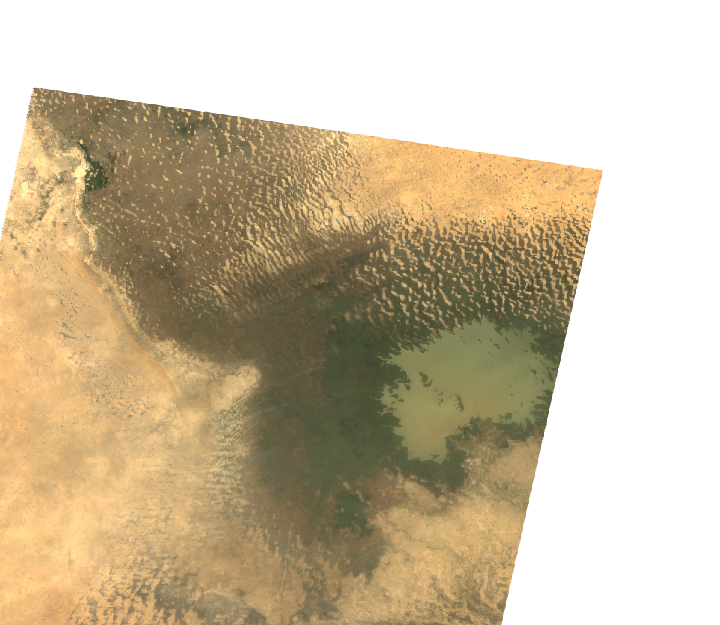

In [7]:
frame_0 = filmstrip_im.crop((0, 0, width, crop_interval))
print(frame_0)
display(frame_0)

Get a font (Consolas)

In [8]:
font_url = 'https://github.com/tsenart/sight/raw/master/fonts/Consolas.ttf'
font_name = 'Consolas.ttf'
urllib.request.urlretrieve(font_url, font_name)

('Consolas.ttf', <http.client.HTTPMessage at 0x78843c1d30d0>)

Figure out annotation position and size

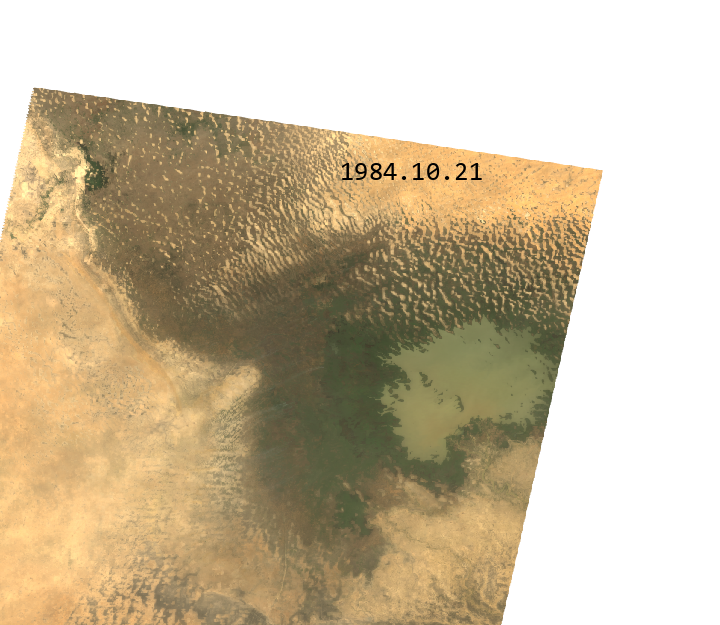

In [9]:
right = 340
down = 160
font_size = 26
fill = '#000'

font = ImageFont.truetype(font_name, font_size)
anno_test = filmstrip_im.crop((0, 0, width, crop_interval))
ImageDraw.Draw(anno_test).text((right, down), dates[0], fill=fill, font=font)
display(anno_test)

Loop through the frames to crop and annotate

In [10]:
for frame, date in enumerate(dates):
    frame_im = filmstrip_im.crop(
        (0, frame*crop_interval, width, (frame+1)*crop_interval))
    ImageDraw.Draw(frame_im).text((right, down), date, fill=fill, font=font)
    frame_im.save(str(frame).zfill(3)+'_frame.png')

Did it work?

Found these frames:

000_frame.png  005_frame.png  010_frame.png  015_frame.png  020_frame.png  025_frame.png
001_frame.png  006_frame.png  011_frame.png  016_frame.png  021_frame.png  026_frame.png
002_frame.png  007_frame.png  012_frame.png  017_frame.png  022_frame.png  027_frame.png
003_frame.png  008_frame.png  013_frame.png  018_frame.png  023_frame.png
004_frame.png  009_frame.png  014_frame.png  019_frame.png  024_frame.png

Final frame:



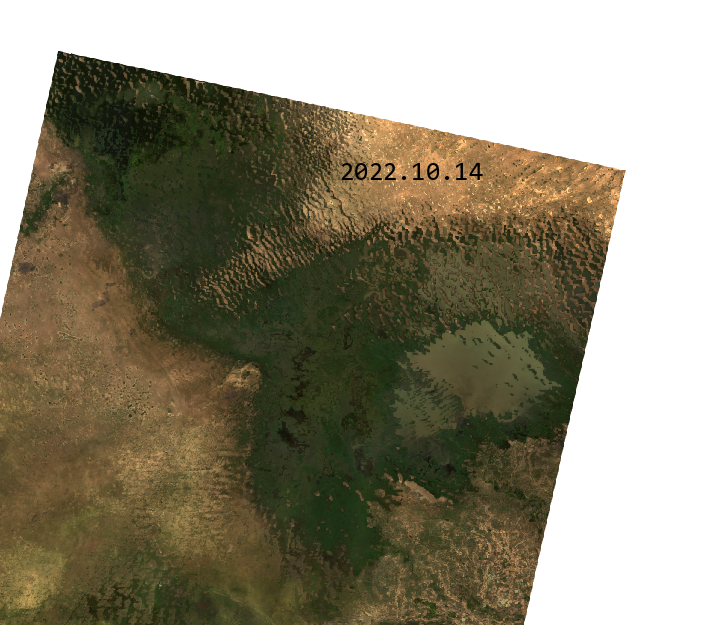

In [11]:
print('Found these frames:\n')
!ls *_frame.png
print('\nFinal frame:\n')
Image.open(str(frame).zfill(3)+'_frame.png')

Make the GIF using ImageMagick

In [12]:
!apt-get update
!apt install imagemagick

Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Get:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:3 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  Packages [1,351 kB]
Get:4 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]
Hit:5 http://archive.ubuntu.com/ubuntu jammy InRelease
Get:6 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]
Get:7 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]
Hit:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Get:9 https://r2u.stat.illinois.edu/ubuntu jammy/main all Packages [8,714 kB]
Hit:10 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Get:11 http://security.ubuntu.com/ubuntu jammy-security/universe amd64 Packages [1,235 kB]
Get:12 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]
Hit:13 https://ppa.launchpadcontent.

In [13]:
import os

In [14]:
gif_name = 'lake_chad.gif'
delay = 30

cmd = f'convert -loop 0 -delay {delay} *_frame.png {gif_name}'
print(cmd)
os.system(cmd)

convert -loop 0 -delay 30 *_frame.png lake_chad.gif


0

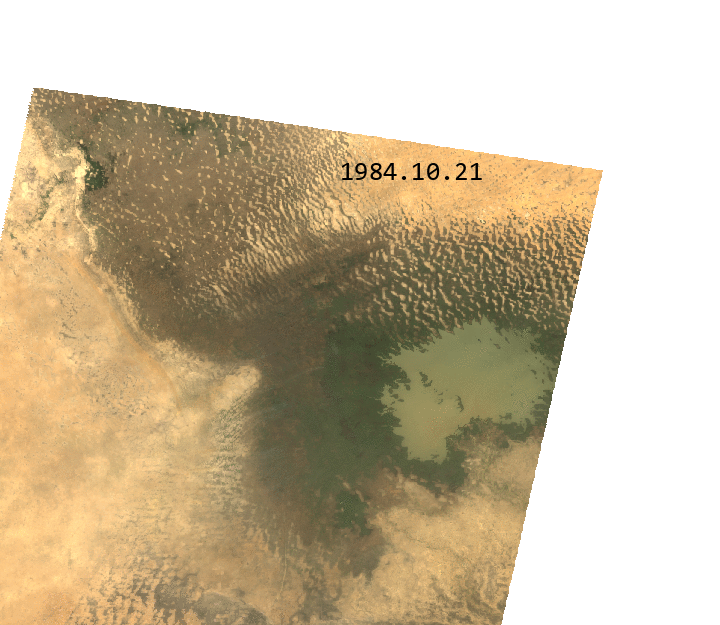

In [15]:
with open('lake_chad.gif','rb') as f:
    display(ImageGIF(data=f.read(), format='png'))

Compress the GIF

In [ ]:
in_gif = 'minqin_JA.gif'
out_gif = 'minqin_JA_compress.gif'
fuzz = 5  # percent

cmd = f'convert -fuzz {fuzz}% -layers Optimize {in_gif} {out_gif}'
print(cmd)
os.system(cmd)

convert -fuzz 5% -layers Optimize minqin_JA.gif minqin_JA_compress.gif


0

Preview the compressed version

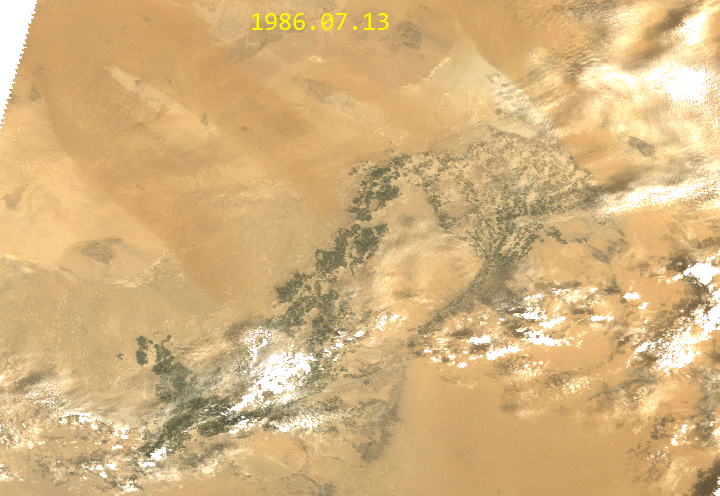

In [ ]:
with open('minqin_JA_compress.gif','rb') as f:
    display(ImageGIF(data=f.read(), format='png'))

Download the animation

In [ ]:
from google.colab import files
files.download(out_gif)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>